In [8]:
from torchvision import models
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torch.nn.functional as F

import numpy as np

!pip install unet
!pip install torchsummary
from torchsummary import summary

You should consider upgrading via the 'C:\Users\91958\Envs\pytorch\Scripts\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'C:\Users\91958\Envs\pytorch\Scripts\python.exe -m pip install --upgrade pip' command.


In [87]:
import torch
import torch.nn as nn
from torchvision import models

def convrelu(in_channels, out_channels, kernel, padding):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel, padding=padding),
        nn.ReLU(inplace=True),
        nn.MaxPool2d(2, 2)
        
    )
def convrelu1(in_channels, out_channels, kernel, padding):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel, padding=padding),
        nn.ReLU(inplace=True)
        
    )

class UNet(nn.Module):
    def __init__(self, n_class):
        super().__init__()
        
        self.convlayer1 = convrelu(3, 64, 3, 1)
        self.convlayer2 = convrelu(64, 128, 3, 1)
        self.convlayer3 = convrelu(128 , 256 , 3, 1)
        self.convlayer4 = convrelu(256, 512 ,3, 1)
        
        self.layer4_1x1 = convrelu1(512, 512, 1, 0)
        self.layer3_1x1 = convrelu1(256, 256, 1, 0)
        self.layer2_1x1 = convrelu1(128, 128, 1, 0)
        self.layer1_1x1 = convrelu1(64, 64, 1, 0)
        
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        
        self.conv_up3 = convrelu1(512+256, 512, 3, 1)
        self.conv_up2 = convrelu1(512+128, 256, 3, 1)
        self.conv_up1 = convrelu1(256+64 , 64, 3, 1)
        

        self.conv_last = nn.Conv2d(64, n_class, 1)
        
        
    
    def forward(self , x):
        
        c1 = self.convlayer1(x)
        c2 = self.convlayer2(c1)
        c3 = self.convlayer3(c2)
        c4 = self.convlayer4(c3)
        
        c4 = self.layer4_1x1(c4)
        x = self.upsample(c4)
        c3 = self.layer3_1x1(c3)
        x = torch.cat([x, c3], dim=1) 
        x = self.conv_up3(x)
        
       
        x = self.upsample(x)
        c2 = self.layer2_1x1(c2)
        x = torch.cat([x, c2], dim=1)
        x = self.conv_up2(x)
        
        
        x = self.upsample(x)
        c1 = self.layer1_1x1(c1)
        x = torch.cat([x, c1], dim=1)
        x = self.conv_up1(x)
        
        x = self.upsample(x)
        
        out = self.conv_last(x)
        return out
               
        
        
net = UNet(6)           

In [88]:
net

classic_UNet(
  (convlayer1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (convlayer2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (convlayer3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (convlayer4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (layer4_1x1): Sequential(
    (0): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1))
    (1): ReLU(inp

In [89]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [90]:
model = UNet(n_class=6)
model = model.to(device)

summary(model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
         MaxPool2d-3         [-1, 64, 112, 112]               0
            Conv2d-4        [-1, 128, 112, 112]          73,856
              ReLU-5        [-1, 128, 112, 112]               0
         MaxPool2d-6          [-1, 128, 56, 56]               0
            Conv2d-7          [-1, 256, 56, 56]         295,168
              ReLU-8          [-1, 256, 56, 56]               0
         MaxPool2d-9          [-1, 256, 28, 28]               0
           Conv2d-10          [-1, 512, 28, 28]       1,180,160
             ReLU-11          [-1, 512, 28, 28]               0
        MaxPool2d-12          [-1, 512, 14, 14]               0
           Conv2d-13          [-1, 512, 14, 14]         262,656
             ReLU-14          [-1, 512,

In [100]:
import scipy.io
mat = scipy.io.loadmat('C:\\Users\\91958\\stage1\\Subject_01.mat\\Subject_01.mat')

In [101]:
mat

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sat Mar 07 12:12:16 2015',
 '__version__': '1.0',
 '__globals__': [],
 'images': array([[[255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         ...,
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255]],
 
        [[255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         ...,
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255]],
 
        [[255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         ...,
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 2

In [102]:
img_tensor = mat['images']
manual_fluid_tensor_1 = mat['manualFluid1']

img_array = np.transpose(img_tensor, (2, 0, 1))
manual_fluid_array = np.transpose(manual_fluid_tensor_1, (2, 0, 1))

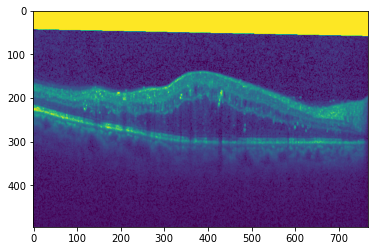

In [103]:
plt.imshow(img_array[25])

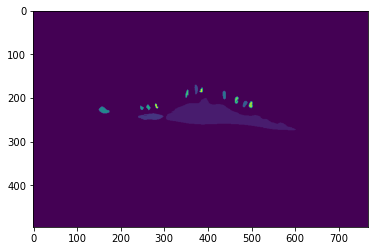

In [104]:
plt.imshow(manual_fluid_array[25])

In [105]:
transform = torchvision.transforms.Compose([torchvision.transforms.Resize((224, 224)),       
                                            torchvision.transforms.ToTensor(),
                                            torchvision.transforms.Normalize(mean = [0.485, 0.456, 0.406],
                                            std = [0.229, 0.224, 0.225])])

In [120]:
img_array = np.transpose(img_tensor, (2, 0 ,1))/255 

In [125]:
img_array.shape[0]

61

In [124]:
img_tensor.shape

(496, 768, 61)

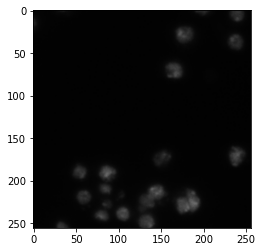

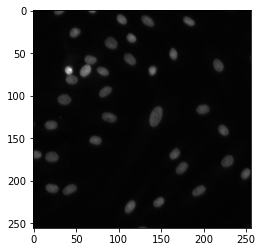

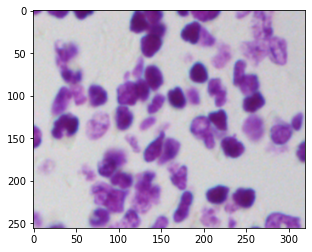

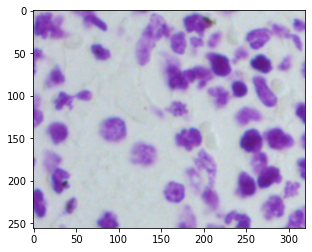

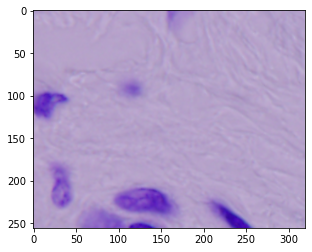

...

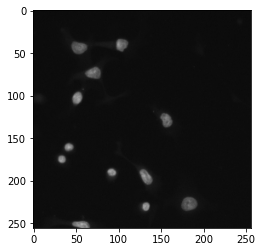

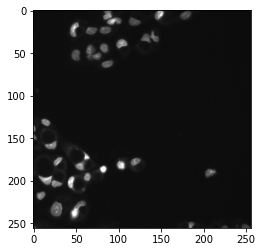

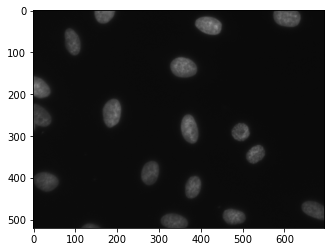

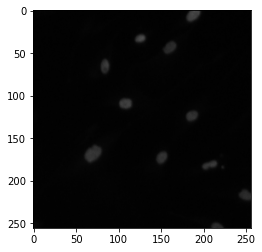

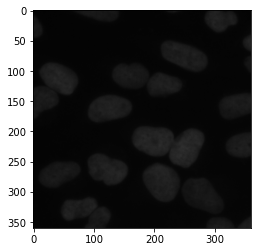

In [148]:
import os
os.listdir(stage1_images_dir)
for img_dir in os.listdir(stage1_images_dir):
    for img in os.listdir(stage1_images_dir +img_dir + '/images'):
        show_image = Image.open(stage1_images_dir +img_dir + '/images/'+img)
        plt.imshow(show_image) 
        plt.show()

In [168]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [185]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, datasets, models

class SimDataset():
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform

    

    def __getitem__(self, idx):
        
        X_train = np.zeros((len(os.listdir(self.data_dir)), 128, 128, 3), dtype = np.uint8)
        Y_train = np.zeros((len(os.listdir(self.data_dir)), 128, 128, 1), dtype = np.bool)
        
        
        for n, train_dir in os.listdir(self.data_dir):
            print(train_dir)
            for img in os.listdir(self.data_dir +train_dir + '/images'):
                img = mpimg.imread(self.data_dir +train_dir + '/images/'+ img ).convert('RGB')
                img = img.reshape([len(os.listdir(self.data_dir)), 128,128,3])
                X_train[n] = img
                
            for n, mask in os.listdir(self.data_dir +train_dir + '/masks'):
                mask = Image.open(self.data_dir +img_dir + '/masks/'+mask)
                mask = mask.reshape([len(os.listdir(self.data_dir)), 128,128,1])
                Y_train[n] = mask
        
        if self.transform:
            X_train = self.transform(X_train)
            Y_train = self.transform(Y_train)
            
        print(X_train)  
        return [X_train, Y_train]
    
    
    
    def __len__(self):
        return len(os.listdir(self.data_dir))

       

In [186]:
data_dir = "C:\\Users\\91958\\stage1\\stage1_train\\"

trans = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # imagenet
])

SimDataset( data_dir, transform = trans)

In [196]:


!pip install -U scikit-image
!pip install tqdm  ###Instantly make your loops show a smart progress meter


from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize

  Using cached scikit_image-0.17.2-cp37-cp37m-win_amd64.whl (11.5 MB)
  Using cached imageio-2.9.0-py3-none-any.whl (3.3 MB)


You should consider upgrading via the 'C:\Users\91958\Envs\pytorch\Scripts\python.exe -m pip install --upgrade pip' command.


In [197]:
from tqdm import tqdm

train_path = "C:\\Users\\91958\\stage1\\stage1_train\\"

train_ids = next(os.walk(train_path))[1]


IMG_WIDTH = 128
IMG_HEIGHT = 128
IMG_CHANNELS = 3


images = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
labels = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)


print('Getting and resizing train images and masks ... ')

for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
    path = train_path + id_
    img = mpimg.imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    images[n] = img
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    
    
    for mask_file in next(os.walk(path + '/masks/'))[2]:
        mask_ = mpimg.imread(path + '/masks/' + mask_file)
        mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                      preserve_range=True), axis=-1)
        mask = np.maximum(mask, mask_)
    labels[n] = mask

X_train = images
Y_train = labels

  0%|                                                                                                                                                                                     | 0/670 [00:00<?, ?it/s]

Getting and resizing train images and masks ... 


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 670/670 [10:08<00:00,  1.10it/s]


In [199]:
Y_train

array([[[[False],
         [False],
         [False],
         ...,
         [ True],
         [False],
         [False]],

        [[False],
         [False],
         [False],
         ...,
         [ True],
         [False],
         [False]],

        [[False],
         [False],
         [False],
         ...,
         [ True],
         [False],
         [False]],

        ...,

        [[False],
         [False],
         [False],
         ...,
         [False],
         [False],
         [False]],

        [[False],
         [False],
         [False],
         ...,
         [False],
         [False],
         [False]],

        [[False],
         [False],
         [False],
         ...,
         [False],
         [False],
         [False]]],


       [[[False],
         [False],
         [False],
         ...,
         [False],
         [False],
         [False]],

        [[False],
         [False],
         [False],
         ...,
         [False],
         [False],
         [Fa